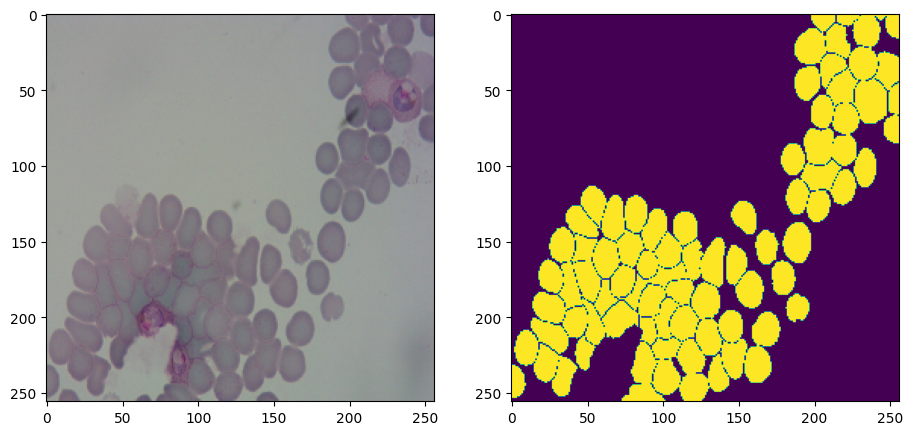

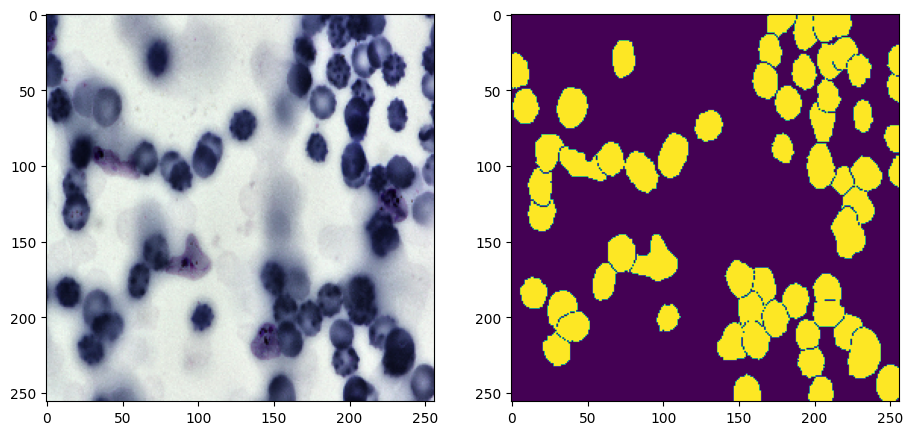

In [1]:
# Part 01. Load packages and libs
import warnings
import os
import time
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader

from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2

torch.cuda.empty_cache()

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

warnings.filterwarnings("ignore")


# Part 02. Writing a custom dataset for Blood Cell Segmemtation dataset, write data loader to load data for train model
TRAIN_IMG_DIR = "train/original"
TRAIN_MASK_DIR = "train/mask"
VAL_IMG_DIR = "test/original"
VAL_MASK_DIR = "test/mask"


class BloodCellDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None) -> None:
        super(BloodCellDataset, self).__init__()
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        image_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(
            self.mask_dir, self.images[index].replace(".jpg", ".png"))

        image = np.array(Image.open(image_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"),
                        dtype=np.float32)  # l -> grayscale
        mask[mask == 255.0] = 1.0  # convert value of pixel to binary

        if self.transform is not None:
            augemantations = self.transform(image=image, mask=mask)
            image = augemantations['image']
            mask = augemantations['mask']
        return image, mask
# Data loader func


def get_data_loaders(
        train_dir, train_mask_dir, val_dir, val_maskdir, batch_size,
        train_transform, val_transform):

    train_ds = BloodCellDataset(
        image_dir=train_dir, mask_dir=train_mask_dir,
        transform=train_transform)

    train_loader = DataLoader(
        train_ds,
        batch_size=batch_size,
        shuffle=True,
    )

    val_ds = BloodCellDataset(
        image_dir=val_dir,
        mask_dir=val_maskdir,
        transform=val_transform,
    )

    val_loader = DataLoader(
        val_ds,
        batch_size=batch_size,
        shuffle=False,
    )

    return train_loader, val_loader


# Define transform for dataset
train_transform = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=256, width=256),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)
# Transform data and load data for train model by data loader
BATCH_SIZE = 2
train_loader, val_loader = get_data_loaders(
    TRAIN_IMG_DIR,
    TRAIN_MASK_DIR,
    VAL_IMG_DIR,
    VAL_MASK_DIR,
    BATCH_SIZE,
    train_transform,
    val_transforms
)
# Visualize some sample data in data loader after transform and load data


def show_transformed(data_loader):
    batch = next(iter(data_loader))
    images, labels = batch

    for img, mask in zip(images, labels):
        plt.figure(figsize=(11, 11))

        plt.subplot(1, 2, 1)
        plt.imshow(np.transpose(img, (1, 2, 0)))

        plt.subplot(1, 2, 2)
        plt.imshow(mask.reshape(mask.shape[0], mask.shape[1], 1))


show_transformed(val_loader)

In [2]:
train_loader.dataset[0][0].shape

torch.Size([3, 256, 256])

In [3]:
train_loader.dataset[0][1].shape

torch.Size([256, 256])

In [4]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ResidualBlock, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, stride=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, stride=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        self.skip = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1) if in_channels != out_channels else nn.Identity()
        
    def forward(self, x):
        residual = self.skip(x)
        x = F.relu(self.bn1(self.conv1(x)))
        x = self.bn2(self.conv2(x))
        x += residual
        return F.relu(x)
    
class DownTransition(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownTransition, self).__init__()
        
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.conv_block = ResidualBlock(in_channels, out_channels)
    
    def forward(self, x):
        x = self.pool(x)
        x = self.conv_block(x)
        
        return x 

class UpTransition(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UpTransition, self).__init__()
        
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.conv_block = ResidualBlock(in_channels, out_channels)
    
    def forward(self, x1, x2):
        x1 = self.up(x1)
        x = torch.cat([x1, x2], dim=1)
        x = self.conv_block(x)
        
        return x
        

In [5]:
class VNet(nn.Module):
    def __init__(self, n_classes, n_channels):
        super(VNet, self).__init__()
        
        self.n_classes = n_classes  
        self.n_channels = n_channels
        
        self.input = ResidualBlock(n_channels, 16)
        
        self.down1 = DownTransition(16, 32)
        self.down2 = DownTransition(32, 64)
        self.down3 = DownTransition(64, 128)   
        self.down4 = DownTransition(128, 256)
        
        
        self.up4 = UpTransition(256, 128)
        self.up3 = UpTransition(128, 64)
        self.up2 = UpTransition(64, 32)
        self.up1 = UpTransition(32, 16)
        
        self.output = nn.Conv2d(16, n_classes, kernel_size=1)
        
    def forward(self, x):
        input = self.input(x)   
        
        down1= self.down1(input)
        down2= self.down2(down1)
        down3= self.down3(down2)
        
        down4= self.down4(down3)
        
        up4 = self.up4(down4, down3)
        up3 = self.up3(up4, down2)
        up2 = self.up2(up3, down1)
        up1 = self.up1(up2, input)
        
        output = self.output(up1)
        return output     

In [6]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()
        self.bce_losss = nn.BCEWithLogitsLoss()

    def forward(self, inputs, targets, smooth=1):
        BCE = self.bce_losss(inputs, targets)

        # comment out if the model contains a sigmoid or equivalent activation layer
        inputs = torch.sigmoid(inputs)

        # flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)

        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(
            inputs.sum() + targets.sum() + smooth)
        Dice_BCE = BCE + dice_loss

        return Dice_BCE


class IOU(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(IOU, self).__init__()

    def forward(self, inputs, targets, smooth=1):

        # comment out if the model contains a sigmoid or equivalent activation layer
        inputs = torch.sigmoid(inputs)

        # flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)

        # intersection is equivalent to True Positive count
        # union is the mutually inclusive area of all labels & predictions
        intersection = (inputs * targets).sum()
        total = (inputs + targets).sum()
        union = total - intersection

        IoU = (intersection + smooth)/(union + smooth)

        return IoU

In [7]:
model = VNet(n_classes=1, n_channels=3).to(DEVICE)
loss_fn = DiceBCELoss()

iou_fn = IOU()
scaler = torch.cuda.amp.GradScaler()
LEARNING_RATE = 1e-4
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_iou = []
train_loss = []


def save_checkpoint(state, filename="model_VNet.pth.tar"):
    print("=> Saving checkpoint")
    torch.save(state, filename)
    
start_time = time.time()

NUM_EPOCHS = 10

In [8]:
from torchsummary import summary

summary(model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 256, 256]              64
            Conv2d-2         [-1, 16, 256, 256]             448
       BatchNorm2d-3         [-1, 16, 256, 256]              32
            Conv2d-4         [-1, 16, 256, 256]           2,320
       BatchNorm2d-5         [-1, 16, 256, 256]              32
     ResidualBlock-6         [-1, 16, 256, 256]               0
         MaxPool2d-7         [-1, 16, 128, 128]               0
            Conv2d-8         [-1, 32, 128, 128]             544
            Conv2d-9         [-1, 32, 128, 128]           4,640
      BatchNorm2d-10         [-1, 32, 128, 128]              64
           Conv2d-11         [-1, 32, 128, 128]           9,248
      BatchNorm2d-12         [-1, 32, 128, 128]              64
    ResidualBlock-13         [-1, 32, 128, 128]               0
   DownTransition-14         [-1, 32, 1

In [9]:
for epoch in range(NUM_EPOCHS):
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}")
    
    iterations = 0
    iter_loss = 0.0
    iter_iou = 0.0
    
    batch_loop = tqdm(train_loader)
    for batch_idx, (data, targets) in enumerate(batch_loop):
        
        data = data.to(device=DEVICE)
        targets = targets.float().unsqueeze(1).to(device=DEVICE)
        
        with torch.autocast(device_type=DEVICE, dtype=torch.bfloat16):
            predictions = model(data)
            loss = loss_fn(predictions, targets)
            iou = iou_fn(predictions, targets)
            
            iter_loss += loss.item()
            iter_iou += iou.item()
            
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        iterations += 1
        batch_loop.set_postfix(diceloss=loss.item(), iou=iou.item())
    
    train_loss.append(iter_loss / iterations)
    train_iou.append(iter_iou / iterations)
    
    print(f"Epoch: {epoch+1}/{NUM_EPOCHS}, Training loss: {round(train_loss[-1] , 3)}")
    
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict()
    }
    
    save_checkpoint(checkpoint)
    
    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()
    
    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(DEVICE)
            y = y.to(DEVICE).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds = (preds > 0.5).float()
            num_correct += (preds == y).sum()
            num_pixels += torch.numel(preds)
            dice_score += (2 * (preds * y).sum()) / (
                (preds + y).sum() + 1e-8
            )

    print(
        f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.2f}"
    )
    print(f"Dice score: {dice_score/len(val_loader)}")
    model.train()

print("That's it!")

end_time = time.time()
training_time = end_time - start_time
print(f"The training time of the V-Net model is: {training_time:.2f} seconds")

Epoch: 1/10


100%|██████████| 585/585 [04:06<00:00,  2.37it/s, diceloss=0.113, iou=0.844] 


Epoch: 1/10, Training loss: 0.396
=> Saving checkpoint
Got 10073960/10420224 with acc 96.68
Dice score: 0.9469640851020813
Epoch: 2/10


100%|██████████| 585/585 [03:41<00:00,  2.65it/s, diceloss=0.239, iou=0.798] 


Epoch: 2/10, Training loss: 0.15
=> Saving checkpoint
Got 9694917/10420224 with acc 93.04
Dice score: 0.9065887331962585
Epoch: 3/10


100%|██████████| 585/585 [03:35<00:00,  2.72it/s, diceloss=0.0728, iou=0.924]


Epoch: 3/10, Training loss: 0.134
=> Saving checkpoint
Got 10048577/10420224 with acc 96.43
Dice score: 0.9401604533195496
Epoch: 4/10


100%|██████████| 585/585 [03:33<00:00,  2.74it/s, diceloss=0.0945, iou=0.913]


Epoch: 4/10, Training loss: 0.121
=> Saving checkpoint
Got 10093549/10420224 with acc 96.86
Dice score: 0.948760986328125
Epoch: 5/10


100%|██████████| 585/585 [03:31<00:00,  2.77it/s, diceloss=0.0797, iou=0.922]


Epoch: 5/10, Training loss: 0.119
=> Saving checkpoint
Got 10071775/10420224 with acc 96.66
Dice score: 0.9443578720092773
Epoch: 6/10


100%|██████████| 585/585 [03:30<00:00,  2.78it/s, diceloss=0.0798, iou=0.92] 


Epoch: 6/10, Training loss: 0.113
=> Saving checkpoint
Got 10103172/10420224 with acc 96.96
Dice score: 0.9503229260444641
Epoch: 7/10


100%|██████████| 585/585 [03:40<00:00,  2.66it/s, diceloss=0.0626, iou=0.939]


Epoch: 7/10, Training loss: 0.109
=> Saving checkpoint
Got 10015346/10420224 with acc 96.11
Dice score: 0.9329134821891785
Epoch: 8/10


100%|██████████| 585/585 [03:44<00:00,  2.60it/s, diceloss=0.0517, iou=0.943]


Epoch: 8/10, Training loss: 0.107
=> Saving checkpoint
Got 10095876/10420224 with acc 96.89
Dice score: 0.9485434889793396
Epoch: 9/10


100%|██████████| 585/585 [03:41<00:00,  2.64it/s, diceloss=0.231, iou=0.872] 


Epoch: 9/10, Training loss: 0.105
=> Saving checkpoint
Got 10133935/10420224 with acc 97.25
Dice score: 0.9555627107620239
Epoch: 10/10


100%|██████████| 585/585 [03:46<00:00,  2.59it/s, diceloss=0.115, iou=0.925] 


Epoch: 10/10, Training loss: 0.102
=> Saving checkpoint
Got 10129086/10420224 with acc 97.21
Dice score: 0.9547328352928162
That's it!
The training time of the V-Net model is: 2434.51 seconds


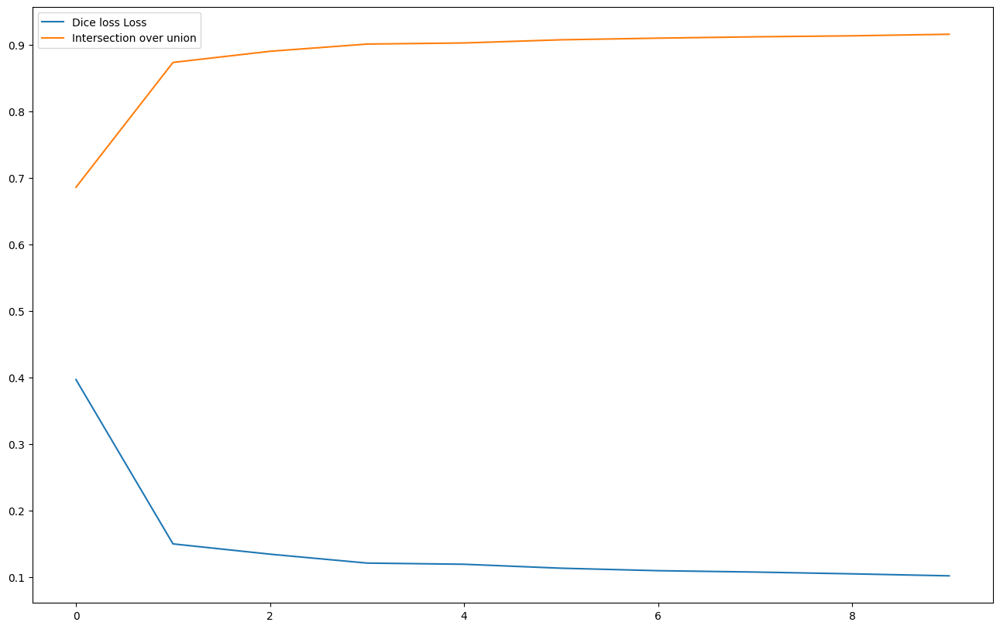

Testing: 100%|██████████| 80/80 [00:19<00:00,  4.03it/s]

Average Dice Score: 0.9547
Average IoU Score: 0.3330


In [10]:
f = plt.figure(figsize=(16, 10))
plt.plot(train_loss, label='Dice loss Loss')
plt.plot(train_iou, label='Intersection over union')
plt.legend()
plt.show()


def test_model(model, val_loader, device):
    model.eval()
    dice_score = 0
    iou_metric = IOU()
    iou_score = 0

    with torch.no_grad():
        for x, y in tqdm(val_loader, desc="Testing"):
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            # Apply sigmoid to get probabilities
            preds = torch.sigmoid(model(x))
            # Threshold to get binary mask
            preds_binary = (preds > 0.5).float()

            # Calculate metrics
            dice_score += (2 * (preds_binary * y).sum()) / (
                (preds_binary + y).sum() + 1e-8
            )
            iou_score += iou_metric(preds_binary, y)

    avg_dice = dice_score / len(val_loader)
    avg_iou = iou_score / len(val_loader)

    print(f"Average Dice Score: {avg_dice:.4f}")
    print(f"Average IoU Score: {avg_iou:.4f}")

    return avg_dice, avg_iou


# Run the test function
avg_dice, avg_iou = test_model(model, val_loader, DEVICE)

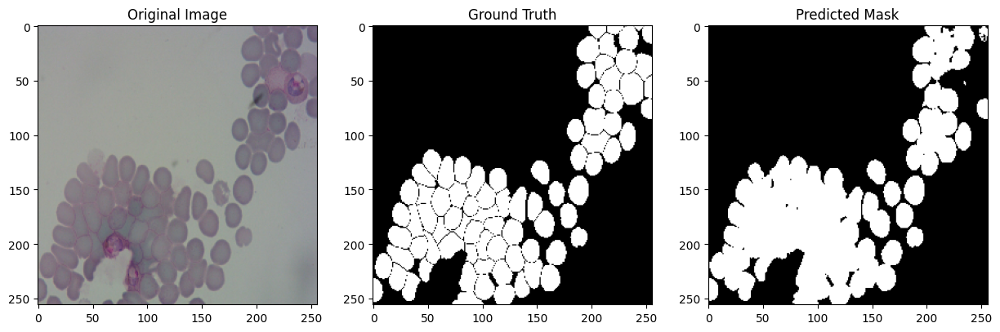

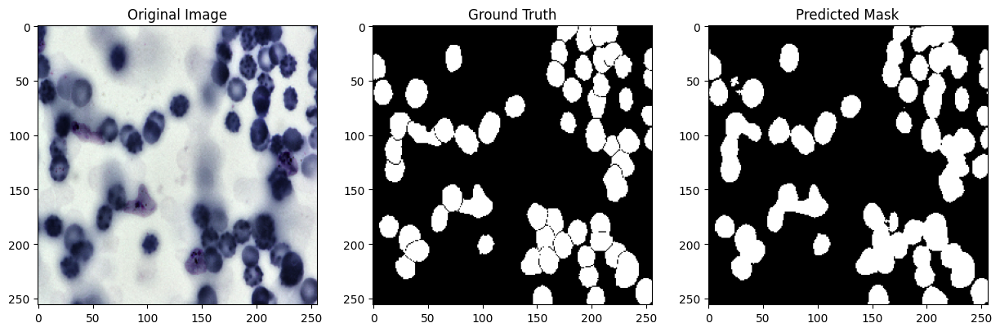

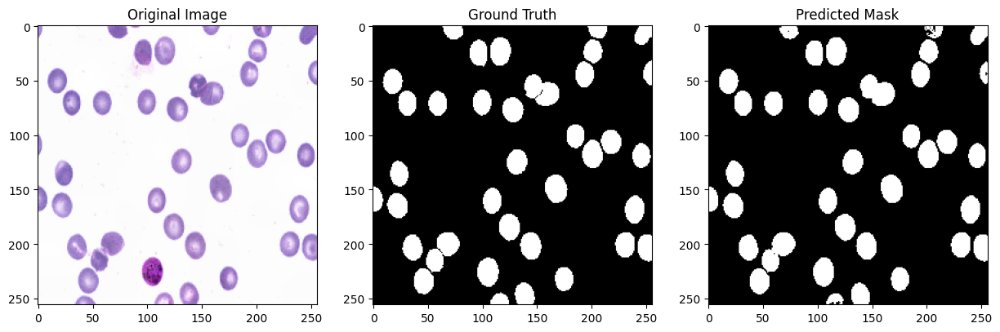

In [11]:
def visualize_predictions(model, val_loader, device, num_samples=3):
    model.eval()
    samples = 0

    with torch.no_grad():
        for x, y in val_loader:
            x = x.to(device)
            y = y.to(device).unsqueeze(1)
            preds = torch.sigmoid(model(x))
            preds_binary = (preds > 0.5).float()

            for i in range(x.size(0)):
                if samples >= num_samples:
                    break

                plt.figure(figsize=(15, 5))

                # Original Image
                plt.subplot(1, 3, 1)
                plt.title("Original Image")
                plt.imshow(np.transpose(x[i].cpu().numpy(), (1, 2, 0)))

                # Ground Truth
                plt.subplot(1, 3, 2)
                plt.title("Ground Truth")
                plt.imshow(y[i].cpu().numpy().squeeze(), cmap="gray")

                # Predicted Mask
                plt.subplot(1, 3, 3)
                plt.title("Predicted Mask")
                plt.imshow(preds_binary[i].cpu(
                ).numpy().squeeze(), cmap="gray")

                plt.show()
                samples += 1

            if samples >= num_samples:
                break


# Visualize predictions
visualize_predictions(model, val_loader, DEVICE)

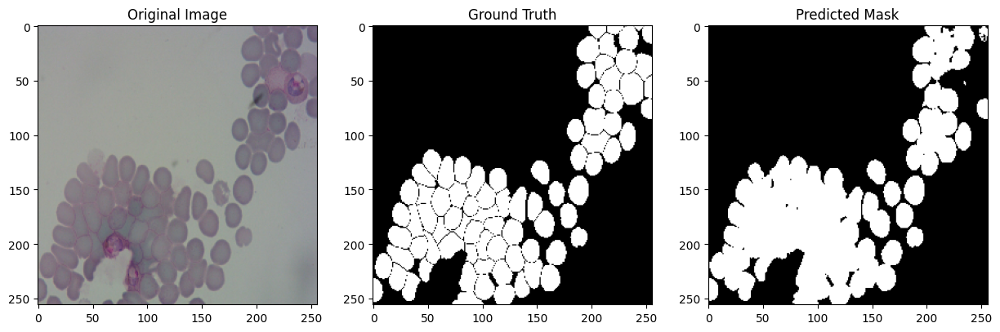

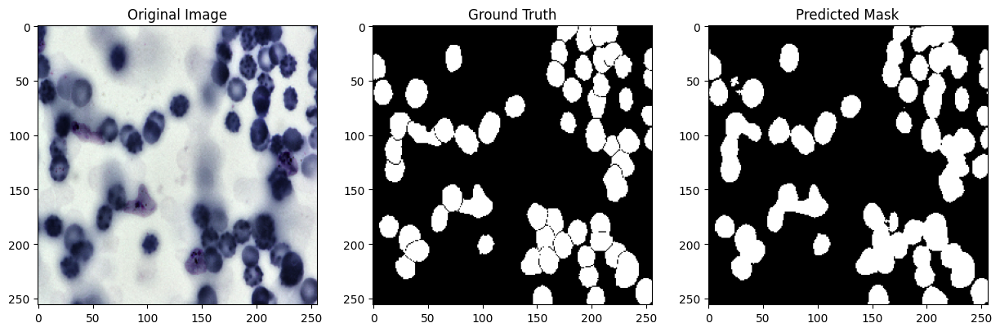

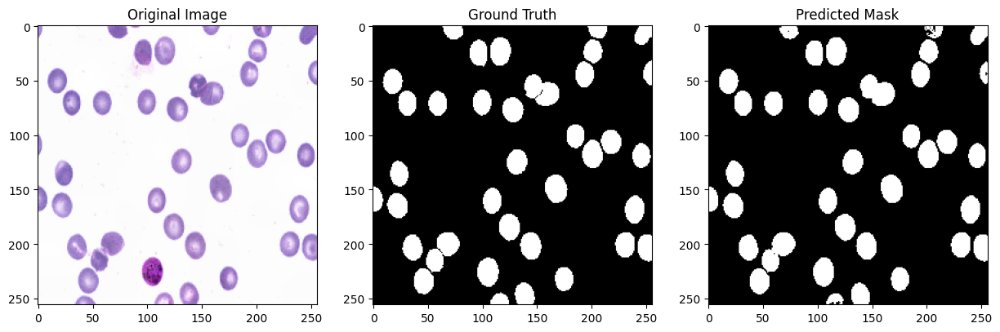

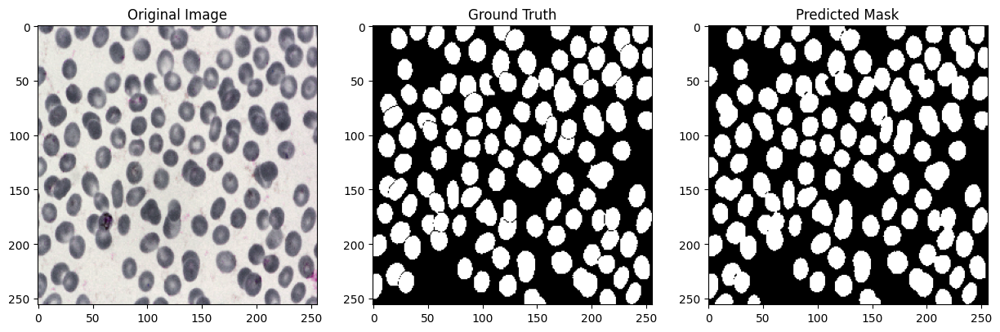

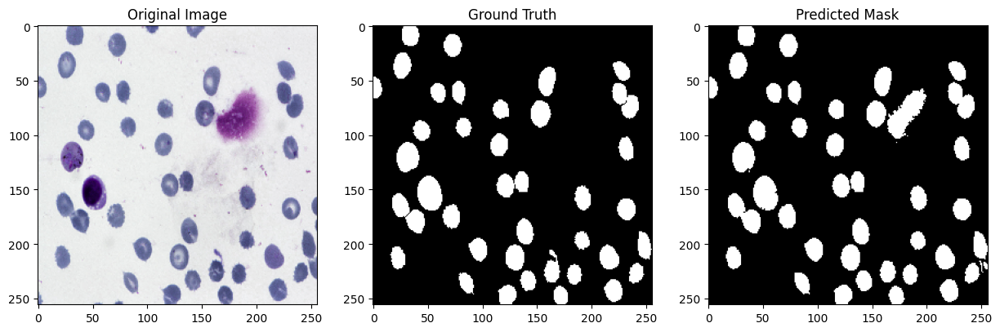

...

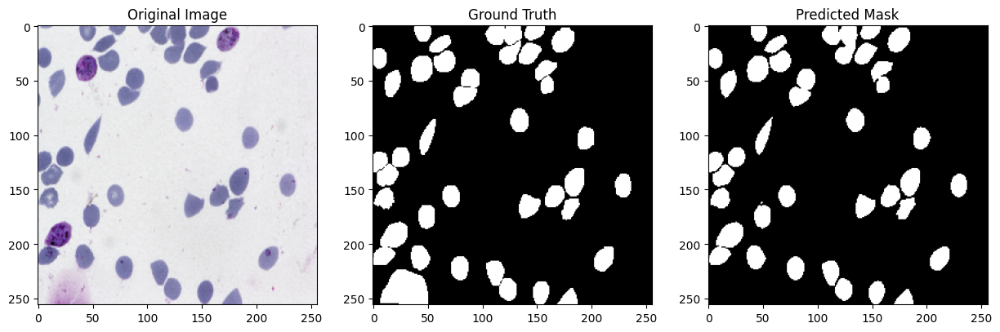

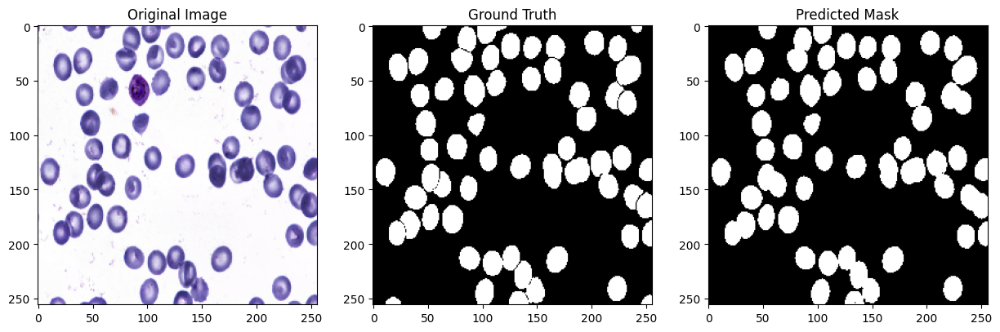

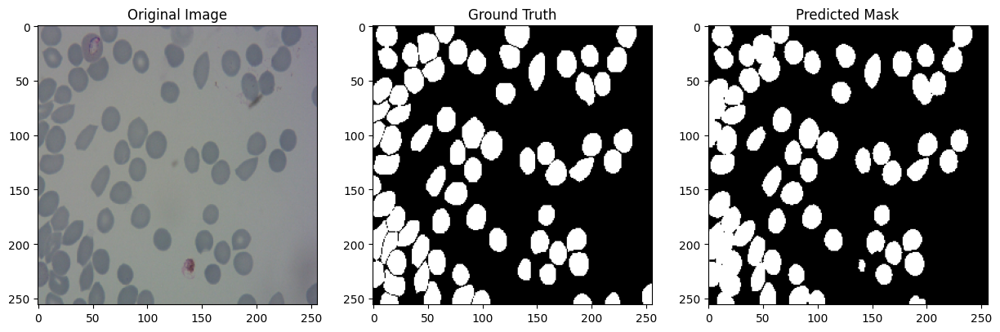

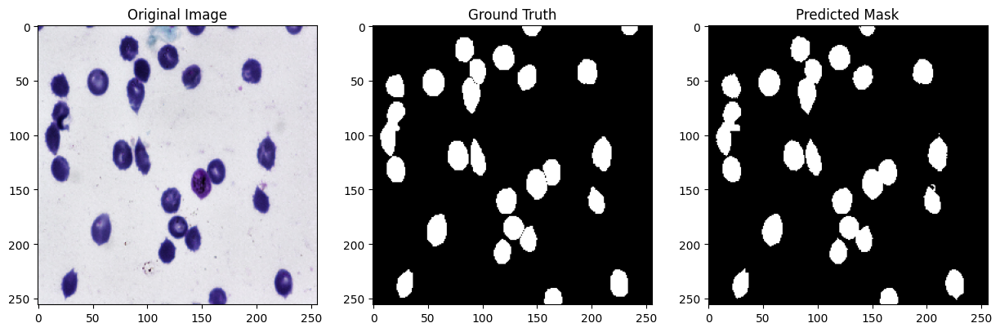

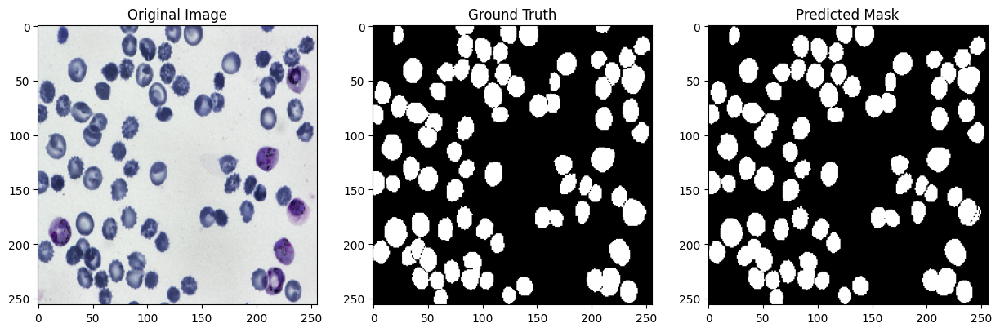

In [12]:
visualize_predictions(model, val_loader, DEVICE, num_samples=100)